In [58]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import os

# Data gathering and cleaning

In [59]:
df=pd.read_excel('ANZ synthesised transaction dataset.xlsx')
pd.set_option('display.max_columns', None)
df.drop(['merchant_code','bpay_biller_code'],axis=1,inplace=True)
df['extraction']=pd.to_datetime(df['extraction'])

In [60]:
df.shape

(12043, 21)

In [61]:
df.head(5)

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,gender,age,merchant_suburb,merchant_state,extraction,amount,transaction_id,country,customer_id,merchant_long_lat,movement
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,F,26,Ashmore,QLD,2018-08-01 01:01:15+00:00,16.25,a623070bfead4541a6b0fff8a09e706c,Australia,CUS-2487424745,153.38 -27.99,debit
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,F,26,Sydney,NSW,2018-08-01 01:13:45+00:00,14.19,13270a2a902145da9db4c951e04b51b9,Australia,CUS-2487424745,151.21 -33.87,debit
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,M,38,Sydney,NSW,2018-08-01 01:26:15+00:00,6.42,feb79e7ecd7048a5a36ec889d1a94270,Australia,CUS-2142601169,151.21 -33.87,debit
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,F,40,Buderim,QLD,2018-08-01 01:38:45+00:00,40.90,2698170da3704fd981b15e64a006079e,Australia,CUS-1614226872,153.05 -26.68,debit
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,F,26,Mermaid Beach,QLD,2018-08-01 01:51:15+00:00,3.25,329adf79878c4cf0aeb4188b4691c266,Australia,CUS-2487424745,153.44 -28.06,debit


# Monthly analysis basic 

In [62]:
#month wise analysis
august=0
september=0
october=0
for i in df['date']:
    if(i.month==8):
        august=august+1
    elif(i.month==9):
        september=september+1
    elif(i.month==10):
        october=october+1

monthly_transactions={"August":august,"September":september,"October":october}
tpm=int((august+september+october)/3) #transactions per month
print(monthly_transactions)
print(tpm)

{'August': 3943, 'September': 4013, 'October': 4087}
4014


In [63]:
avg_transaction_amount=df['amount'].mean()

In [64]:
#seprate dataframe for date and time analysis
df_dt=df.copy()
df_dt['day']=0
df_dt['month']=0
df_dt['hour']=0
df_dt['weekday']=0 
df_dt['count']=1
for i in range(df.shape[0]):
    df_dt['day'][i]=df['date'][i].day
    df_dt['month'][i]=df['date'][i].month
    df_dt['hour'][i]=df['extraction'][i].hour
    df_dt['weekday'][i]=df['date'][i].weekday()
df_dt.sort_values('extraction',ascending=True,inplace=True)
df_dt=df_dt[['amount','date','extraction','day','month','hour','weekday','count']]

C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added 

# Ideal observed day
### Taking the mean of all amounts and visualising a day which had this mean 
### that is 8th september i.e day 43

In [56]:
#day analysis
df_day=df_dt[['amount','date','month']].groupby('date').mean()
df_day=df_day.sort_values('amount')
dm=df_day['amount'].mean()
print(f'the average transaction per day in 3 months is {dm}')
df_day['amount'][43] #closest to mean transaction 2018-08-09 i.e 8th day of september

the average transaction per day in 3 months is 190.61056774083968


193.73691275167783

In [57]:
#analysis of 8th day of september
#segementing a dataframe for average day analysis
df_08=df[(df['month']==8) & (df['day']==9)]
df_08['count']=1
df_08=df_08[['count','hour','amount']]
df_08=df_08.groupby('hour').sum()

KeyError: 'month'

In [ ]:
#visualising an average day
fig,ax=plt.subplots(2,figsize=(10,10))
#amount
df_08['amount'].plot(kind='area',ax=ax[0])
ax[0].set_ylabel('amount')
ax[0].set_title('Amount visualization on an average day 8th sep')

#volume
df_08['count'].plot(kind='line',ax=ax[1],color='yellow')
ax[1].set_ylabel('Volume')
ax[1].set_title('Transaction volume on an average day 8th sep')
fig.tight_layout()
fig.show()

In [ ]:
#for outliers
df_dt.head()

# A Non-existing ideal day

## taking the mean values and representing them instead of an actual Day

In [65]:
#The whole database is segrated just on basis of hour
#can represent the average amount transaction on an hour
#total volume in 3months of an hour
c=0
avg_amount_hour=[]
avg_volume_hour=[]

for i in range(24):
    #print(c)
    df_temp=df_dt[df_dt['hour']==c]
    df_temp['count']=1
    avgh=int(round(df_temp['amount'].mean()))
    volh=int(round((df_temp['count'].sum())/90))
    #print(f"for hour {i} the average amount is {avgh} and the average volume is {volh}")
    avg_amount_hour.append(avgh)
    avg_volume_hour.append(volh)
    c=c+1
    
    

C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:21: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


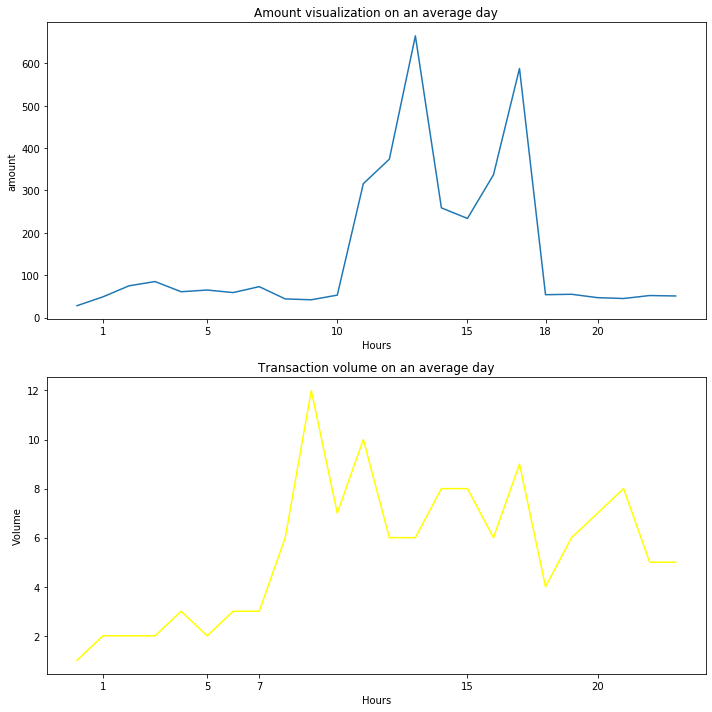

In [69]:
#this visual is considering the whole database and representing an ideal day/average day
df_average=pd.DataFrame()
df_average['hour']=avg_amount_hour
df_average['volume']=avg_volume_hour
df_average.index=[i for i in range(24)]
#visualising an average day
fig,ax=plt.subplots(2,figsize=(10,10))
#amount
df_average['hour'].plot(kind='line',ax=ax[0])
ax[0].set_ylabel('amount')
ax[0].set_title('Amount visualization on an average day')
ax[0].set_xlabel('Hours')
ax[0].set_xticks([1,5,10,15,18,20])
#volume
df_average['volume'].plot(kind='line',ax=ax[1],color='yellow')
ax[1].set_ylabel('Volume')
ax[1].set_title('Transaction volume on an average day')
ax[1].set_xlabel('Hours')
ax[1].set_xticks([1,5,7,15,20])
fig.tight_layout()
fig.show()

In [ ]:
#outliers

# Weekly analysis

In [10]:
#represent the 7 days of an average week
#in 3 months each day occurs  thrice

c=0
avg_amount_week=[]
avg_volume_week=[]

for i in range(7):
    #print(c)
    df_temp=df_dt[df_dt['weekday']==c]
    df_temp['count']=1
    avgw=int(round(df_temp['amount'].mean()))
    div=df_temp.groupby('day').sum().shape[0]
    volw=int(round((df_temp['count'].sum())/div))
    #print(f"for hour {i} the average amount is {avgh} and the average volume is {volh}")
    avg_amount_week.append(avgw)
    avg_volume_week.append(volw)
    c=c+1

C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:22: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


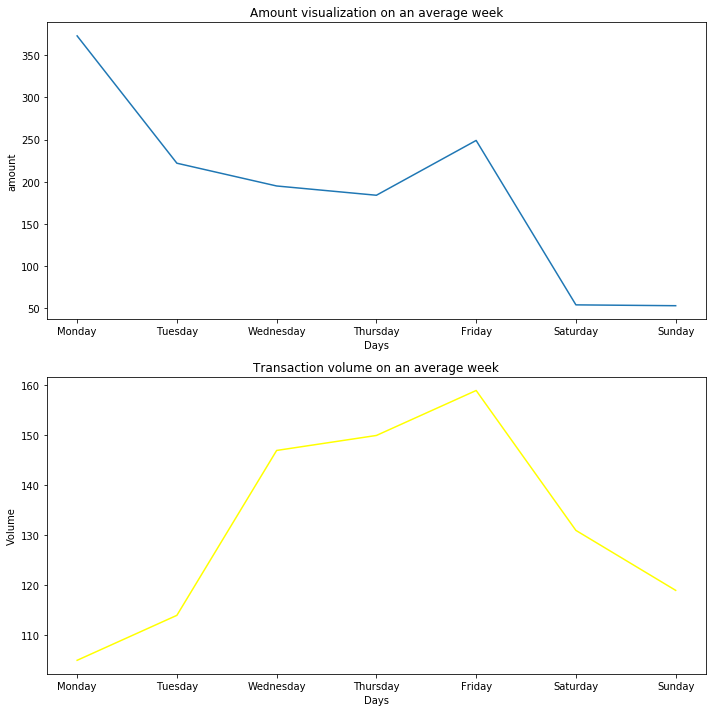

In [28]:
#this visual is considering the whole database and representing an ideal week for every day
df_average_week=pd.DataFrame()
df_average_week['amount']=avg_amount_week
df_average_week['volume']=avg_volume_week
df_average_week.index=[i for i in range(7)]
#visualising an average day
fig,ax=plt.subplots(2,figsize=(10,10))
#amount
df_average_week['amount'].plot(kind='line',ax=ax[0])
ax[0].set_ylabel('amount')
ax[0].set_title('Amount visualization on an average week')
ax[0].set_xticklabels(['','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
ax[0].set_xlabel('Days')

#volume
df_average_week['volume'].plot(kind='line',ax=ax[1],color='yellow')
ax[1].set_ylabel('Volume')
ax[1].set_title('Transaction volume on an average week')
ax[1].set_xticklabels(['','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
ax[1].set_xlabel('Days')
fig.tight_layout()
fig.show()

# Location analysis

In [12]:
import folium

In [13]:
australia=folium.Map(location=[-33.865143,151.209900])
australia

In [14]:
dfloc=df.copy()
dfloc['longitude']=0
dfloc['latitude']=0
for i in range(df.shape[0]):
    dfloc['longitude'][i]=df['long_lat'][i].split()[0]
    dfloc['latitude'][i]=df['long_lat'][i].split()[1]



C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
C:\Users\thake\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
C:\Users\thake\anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [20]:
#visualise
for lat, lon,label in zip(dfloc['latitude'], dfloc['longitude'],df['first_name']):
    label = folium.Popup(str(label), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color='yellow',
        fill=True,
        fill_color='orange',
        fill_opacity=0.7).add_to(australia)
australia
       